# Analysis of August 2019 Lyft Bikeshare Rides
## By Pavan Sabnis

> This dataset includes Lyft's bikeshare trip data for public use. Each entry is a ride by a customer using bicycles that are part of Lyft's bikeshare program

## Investigation Overview

> In this Lyft dataset, the best dependent variable 'to be predicted' in my view would be the end station. Performing an analysis centered on where the user is most likely to travel would be ideal, so that Lyft would know to take action such as include additional bikes at a frequent station, remove stations that are less profitable to maintain, or even include promotions/deals for the user if there happens to be a popular business/destination near where the end station is situated.<br><br>
In addition, however, it is best in general to gain insight into behaviors patterns, or tendencies of the bikeshare users through this data; Understanding this will overall help make better decisions regarding consumer preferences.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sb

%matplotlib inline

In [2]:
bikeshare_data = pd.read_csv('201908-baywheels-tripdata.csv')

This data was measured over the course of August 2019.

In [3]:
bikeshare_data.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip
0,68145,2019-08-31 21:27:42.2530,2019-09-01 16:23:27.4920,249,Russell St at College Ave,37.858473,-122.253253,247,Fulton St at Bancroft Way,37.867789,-122.265896,3112,Customer,NaN,NaN,No
1,53216,2019-08-31 22:34:17.5120,2019-09-01 13:21:13.9310,368,Myrtle St at Polk St,37.785434,-122.419622,78,Folsom St at 9th St,37.773717,-122.411647,2440,Customer,1993.0,Female,No
2,53182,2019-08-31 22:34:49.9420,2019-09-01 13:21:12.4570,368,Myrtle St at Polk St,37.785434,-122.419622,78,Folsom St at 9th St,37.773717,-122.411647,9743,Customer,1995.0,Male,No
3,75682,2019-08-31 14:22:02.2780,2019-09-01 11:23:24.5110,104,4th St at 16th St,37.767045,-122.390833,126,Esprit Park,37.761634,-122.390648,11418,Subscriber,1993.0,Female,No
4,30849,2019-08-31 18:47:08.0570,2019-09-01 03:21:17.6970,327,5th St at San Salvador St,37.332039,-121.881766,327,5th St at San Salvador St,37.332039,-121.881766,1553,Customer,NaN,NaN,No


In [4]:
bikeshare_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 210563 entries, 0 to 210562
Data columns (total 16 columns):
duration_sec               210563 non-null int64
start_time                 210563 non-null object
end_time                   210563 non-null object
start_station_id           210563 non-null int64
start_station_name         210563 non-null object
start_station_latitude     210563 non-null float64
start_station_longitude    210563 non-null float64
end_station_id             210563 non-null int64
end_station_name           210563 non-null object
end_station_latitude       210563 non-null float64
end_station_longitude      210563 non-null float64
bike_id                    210563 non-null int64
user_type                  210563 non-null object
member_birth_year          170774 non-null float64
member_gender              170777 non-null object
bike_share_for_all_trip    210563 non-null object
dtypes: float64(5), int64(4), object(7)
memory usage: 25.7+ MB


<br>
Right away, I notice that member_birth_year and member_gender contain null data. The obvious explanation would be that the participants chose not to include their sensitive information as part of the service or study. But just to be clear, let's examine those specific null data entries to see any patterns:<br>

In [5]:
null_compare_or = bikeshare_data[(bikeshare_data['member_birth_year'].isnull()) | (bikeshare_data['member_gender'].isnull())]
null_compare_and = bikeshare_data[(bikeshare_data['member_birth_year'].isnull()) & (bikeshare_data['member_gender'].isnull())]

In [6]:
null_compare_or

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip
0,68145,2019-08-31 21:27:42.2530,2019-09-01 16:23:27.4920,249,Russell St at College Ave,37.858473,-122.253253,247,Fulton St at Bancroft Way,37.867789,-122.265896,3112,Customer,NaN,NaN,No
4,30849,2019-08-31 18:47:08.0570,2019-09-01 03:21:17.6970,327,5th St at San Salvador St,37.332039,-121.881766,327,5th St at San Salvador St,37.332039,-121.881766,1553,Customer,NaN,NaN,No
5,17193,2019-08-31 20:52:40.7440,2019-09-01 01:39:14.5920,49,S Park St at 3rd St,37.780760,-122.394989,3,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,3503,Customer,NaN,NaN,No
7,9528,2019-08-31 22:04:15.4460,2019-09-01 00:43:03.8740,160,West Oakland BART Station,37.805318,-122.294837,237,Fruitvale BART Station,37.775232,-122.224498,1577,Customer,NaN,NaN,No
8,9542,2019-08-31 22:03:56.5060,2019-09-01 00:42:59.3280,160,West Oakland BART Station,37.805318,-122.294837,237,Fruitvale BART Station,37.775232,-122.224498,2534,Customer,NaN,NaN,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210534,603,2019-08-01 00:58:06.8140,2019-08-01 01:08:09.9020,98,Valencia St at 16th St,37.765052,-122.421866,5,Powell St BART Station (Market St at 5th St),37.783899,-122.408445,172,Customer,NaN,NaN,No
210542,1869,2019-08-01 00:12:22.3800,2019-08-01 00:43:32.1770,144,Precita Park,37.747300,-122.411403,144,Precita Park,37.747300,-122.411403,1890,Customer,NaN,NaN,No
210545,548,2019-08-01 00:21:20.3830,2019-08-01 00:30:28.9080,62,Victoria Manalo Draves Park,37.777791,-122.406432,97,14th St at Mission St,37.768265,-122.420110,3083,Customer,NaN,NaN,No
210548,680,2019-08-01 00:17:22.3420,2019-08-01 00:28:42.4590,312,San Jose Diridon Station,37.329732,-121.901782,310,San Fernando St at 4th St,37.335885,-121.885660,7176,Customer,NaN,NaN,No


In [7]:
null_compare_and

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip
0,68145,2019-08-31 21:27:42.2530,2019-09-01 16:23:27.4920,249,Russell St at College Ave,37.858473,-122.253253,247,Fulton St at Bancroft Way,37.867789,-122.265896,3112,Customer,NaN,NaN,No
4,30849,2019-08-31 18:47:08.0570,2019-09-01 03:21:17.6970,327,5th St at San Salvador St,37.332039,-121.881766,327,5th St at San Salvador St,37.332039,-121.881766,1553,Customer,NaN,NaN,No
5,17193,2019-08-31 20:52:40.7440,2019-09-01 01:39:14.5920,49,S Park St at 3rd St,37.780760,-122.394989,3,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,3503,Customer,NaN,NaN,No
7,9528,2019-08-31 22:04:15.4460,2019-09-01 00:43:03.8740,160,West Oakland BART Station,37.805318,-122.294837,237,Fruitvale BART Station,37.775232,-122.224498,1577,Customer,NaN,NaN,No
8,9542,2019-08-31 22:03:56.5060,2019-09-01 00:42:59.3280,160,West Oakland BART Station,37.805318,-122.294837,237,Fruitvale BART Station,37.775232,-122.224498,2534,Customer,NaN,NaN,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210534,603,2019-08-01 00:58:06.8140,2019-08-01 01:08:09.9020,98,Valencia St at 16th St,37.765052,-122.421866,5,Powell St BART Station (Market St at 5th St),37.783899,-122.408445,172,Customer,NaN,NaN,No
210542,1869,2019-08-01 00:12:22.3800,2019-08-01 00:43:32.1770,144,Precita Park,37.747300,-122.411403,144,Precita Park,37.747300,-122.411403,1890,Customer,NaN,NaN,No
210545,548,2019-08-01 00:21:20.3830,2019-08-01 00:30:28.9080,62,Victoria Manalo Draves Park,37.777791,-122.406432,97,14th St at Mission St,37.768265,-122.420110,3083,Customer,NaN,NaN,No
210548,680,2019-08-01 00:17:22.3420,2019-08-01 00:28:42.4590,312,San Jose Diridon Station,37.329732,-121.901782,310,San Fernando St at 4th St,37.335885,-121.885660,7176,Customer,NaN,NaN,No


<br>
Interestingly, except for 3 entries out of 39789 null entries, it seems that almost all members who chose not to provide their birth year also chose not to provide their gender (from the dimensions of the above output, bottom left corner). For the heck of it, let's get those 3 standalone entries:
<br>

In [8]:
bikeshare_data[(bikeshare_data['member_birth_year'].isnull()) & (bikeshare_data['member_gender'].isnull() == False)]

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip
130594,3885,2019-08-13 11:08:07.3250,2019-08-13 12:12:52.5070,408,MTL-ECO5-01,45.51,-73.57,408,MTL-ECO5-01,45.51,-73.57,6733,Subscriber,NaN,Other,No
199978,335,2019-08-02 14:03:06.6480,2019-08-02 14:08:41.9000,408,MTL-ECO5-01,45.51,-73.57,408,MTL-ECO5-01,45.51,-73.57,6733,Subscriber,NaN,Other,No
207859,348,2019-08-01 10:50:05.9120,2019-08-01 10:55:54.0120,408,MTL-ECO5-01,45.51,-73.57,408,MTL-ECO5-01,45.51,-73.57,6733,Subscriber,NaN,Other,No


Wow, so it looks like 'Other' was chosen as the gender instead of the user having just skipped this information entry. Two possible explanations for this could be either laziness on the side of the user, or that the users may indeed prefer an alternative gender label. Moreover, these 3 ride entries are completely identical in terms of the start station and the end station, and the same bike was used as shown in 'bike_id' (only the duration and start/end time is different). It's fairly plausible that this is all just one user, who of all users given, only revealed their gender preference but not their birth year.  

It's also notable to keep in mind that the entered birth/gender info in this dataset can be inaccurately entered by the users as well.

Let's see the proportion of null entries that are subscribers vs customers, compared to the rest of the dataset. 

Null entries:

In [9]:
null_compare_or['user_type'].value_counts() / null_compare_or.shape[0]

Customer      0.929629
Subscriber    0.070371
Name: user_type, dtype: float64

<br>The rest of the dataset: 

In [10]:
non_null = bikeshare_data.drop(index=null_compare_or.index)
non_null['user_type'].value_counts() / non_null.shape[0]

Subscriber    0.949372
Customer      0.050628
Name: user_type, dtype: float64

<br>Okay, so there isn't a notable distinction in user type between the null/not null entries.

We are given starting and ending latitude and longitude. Let's try to add another column containing the distance traveled for the ride: 

In [11]:
# Function for calculating distance
# from math import sin, cos, sqrt, atan2, radians

def getDistance(lat1, lon1, lat2, lon2):
# approximate radius of earth in km
    R = 6373.0
    
    lat1 = np.radians(lat1)
    lon1 = np.radians(lon1)
    lat2 = np.radians(lat2)
    lon2 = np.radians(lon2)

    dlon = lon2 - lon1
    dlat = lat2 - lat1
    
    a = np.sin(dlat / 2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2)**2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))

    distance = R * c
    return distance

In [12]:
# Test
print(getDistance(37.858473, -122.253253, 37.867789, -122.265896))

1.5186677754886848


In [13]:
# Create new 'route_distance' column here indicating ride distance

# bikeshare_data['route_distance'] = bikeshare_data.apply(getDistance(lat1='start_station_latitude', lon1='start_station_longitude', lat2='end_station_latitude', lon2='end_station_longitude'), axis=1)
# df['col_3'] = df[['col_1','col_2']].apply(lambda x: f(*x), axis=1)
#df['col_3'] = df.apply(lambda x: get_sublist(x.col_1, x.col_2), axis=1)
bikeshare_data['route_distance'] = bikeshare_data.apply(lambda x: getDistance(x.start_station_latitude, x.start_station_longitude, x.end_station_latitude, x.end_station_longitude), axis=1)


In [14]:
# Cast start and end time to datetime format
bikeshare_data['start_time'] = pd.to_datetime(bikeshare_data['start_time'])
bikeshare_data['end_time'] = pd.to_datetime(bikeshare_data['end_time'])

In [15]:
# Create new 'member_age' column here indicating user age (if member birth year is present)
bikeshare_data['member_age'] = bikeshare_data.apply(lambda x: (x.start_time.year - x.member_birth_year) if (x.member_birth_year != np.nan) else np.nan, axis=1)


In [16]:
bikeshare_data.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip,route_distance,member_age
0,68145,2019-08-31 21:27:42.253,2019-09-01 16:23:27.492,249,Russell St at College Ave,37.858473,-122.253253,247,Fulton St at Bancroft Way,37.867789,-122.265896,3112,Customer,NaN,NaN,No,1.518700,NaN
1,53216,2019-08-31 22:34:17.512,2019-09-01 13:21:13.931,368,Myrtle St at Polk St,37.785434,-122.419622,78,Folsom St at 9th St,37.773717,-122.411647,2440,Customer,1993.0,Female,No,1.479856,26.0
2,53182,2019-08-31 22:34:49.942,2019-09-01 13:21:12.457,368,Myrtle St at Polk St,37.785434,-122.419622,78,Folsom St at 9th St,37.773717,-122.411647,9743,Customer,1995.0,Male,No,1.479856,24.0
3,75682,2019-08-31 14:22:02.278,2019-09-01 11:23:24.511,104,4th St at 16th St,37.767045,-122.390833,126,Esprit Park,37.761634,-122.390648,11418,Subscriber,1993.0,Female,No,0.602006,26.0
4,30849,2019-08-31 18:47:08.057,2019-09-01 03:21:17.697,327,5th St at San Salvador St,37.332039,-121.881766,327,5th St at San Salvador St,37.332039,-121.881766,1553,Customer,NaN,NaN,No,0.000000,NaN


In [17]:
bikeshare_data.describe()

,duration_sec,start_station_id,start_station_latitude,start_station_longitude,end_station_id,end_station_latitude,end_station_longitude,bike_id,member_birth_year,route_distance,member_age
count,210563.00000,210563.000000,210563.000000,210563.000000,210563.000000,210563.000000,210563.000000,210563.000000,170774.000000,210563.000000,170774.000000
mean,833.51472,144.829481,37.770058,-122.354407,140.921145,37.770268,-122.353604,4048.755897,1984.964450,1.675576,34.035550
std,1928.22378,120.128023,0.102810,0.217648,118.990674,0.102675,0.217245,3639.124465,10.037432,1.060921,10.037432
min,61.00000,3.000000,37.311284,-122.473658,3.000000,37.311284,-122.473658,12.000000,1878.000000,0.000000,18.000000
25%,376.00000,50.000000,37.770407,-122.412408,44.000000,37.770407,-122.411306,1312.000000,1980.000000,0.931758,27.000000
50%,593.00000,104.000000,37.780526,-122.398285,99.000000,37.780787,-122.397437,2629.000000,1987.000000,1.445961,32.000000
75%,914.00000,240.000000,37.795393,-122.294837,233.000000,37.797280,-122.294837,9241.000000,1992.000000,2.190786,39.000000
max,85492.00000,459.000000,45.510000,-73.570000,459.000000,45.510000,-73.570000,11945.000000,2001.000000,67.465996,141.000000


# Begin Univariate Exploration

This Lyft bikeshare dataset is set at a somewhat different level than other datasets in the course, such as the diamonds dataset. In the diamonds dataset, our analysis centered around being able to predict the price of a given diamond based on its association with other labels and variables in the dataset. In the Lyft dataset, the best dependent variable 'to be predicted' in my view would be the end station. Performing an analysis centered on where the user is most likely to travel would be ideal, so that Lyft would know to take action such as include additional bikes at a frequent station, remove stations that are less profitable to maintain, or even include promotions/deals for the user if there happens to be a popular business/destination near where the end station is situated. 
<br>
<br>
In addition, however, it is best in general to gain insight into behaviors patterns, or tendencies of the bikeshare users through this data; Understanding this will overall help make better decisions regarding consumer preferences.

#### Let's analyze the end stations variable:

In [18]:
end_station_counts = bikeshare_data['end_station_name'].value_counts()
end_station_counts

San Francisco Caltrain Station 2  (Townsend St at 4th St)    7249
San Francisco Ferry Building (Harry Bridges Plaza)           4495
Montgomery St BART Station (Market St at 2nd St)             4257
Berry St at 4th St                                           4076
Market St at 10th St                                         3328
                                                             ... 
Kerley Dr at Rosemary St                                        9
Williams Ave at Apollo St                                       8
1st St at Younger Ave                                           7
Utah St at 24th St                                              7
MTL-ECO5-01                                                     3
Name: end_station_name, Length: 377, dtype: int64

At first, I thought I had noticed several duplicates in the end_station_name column, but I realized there were just a sheer large number of stations available, some with minute station name differences, such as Powell St BART Station (Market St at 4th St) and Powell St BART Station (Market St at 5th St).  

There are 377 stations included as end stations. It seems like 'San Francisco Caltrain Station 2  (Townsend St at 4th St)' is the most frequent end destination numbers-wise, with 7249 users stopping there from August 5 to September 18, 2019, and 'Utah St at 24th St' is the least frequent (I could not find MTL-ECO5-01 as a valid location). 

In [19]:
bikeshare_data['end_station_name'].value_counts().tail()

Kerley Dr at Rosemary St     9
Williams Ave at Apollo St    8
1st St at Younger Ave        7
Utah St at 24th St           7
MTL-ECO5-01                  3
Name: end_station_name, dtype: int64

It's really not worth doing a bar chart of this variable, due to the large number of stations present. 

#### Let's analyze duration time (given in seconds):

In [20]:
bikeshare_data['duration_sec'].describe()

count    210563.00000
mean        833.51472
std        1928.22378
min          61.00000
25%         376.00000
50%         593.00000
75%         914.00000
max       85492.00000
Name: duration_sec, dtype: float64

The mean ride duration time is 833 seconds (about 13 minutes) and the maximum duration time in this dataset is a whopping 85492 seconds (almost 24 hours!).

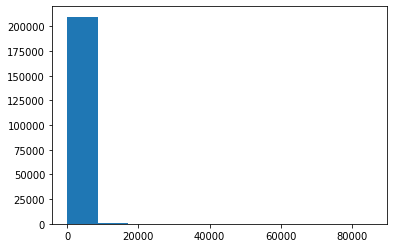

In [21]:
plt.hist(data=bikeshare_data, x='duration_sec');

Clearly, there are outliers present that are dragging the x-axis way high. The mean of this data is 833, so I'll use custom edges to narrow it down. 

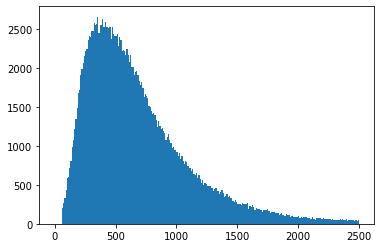

In [22]:
bin_edges = np.arange(0, 2500 + 10, 10)
plt.hist(data=bikeshare_data, x='duration_sec', bins=bin_edges);

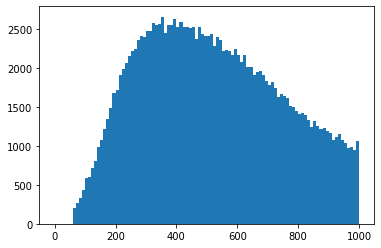

In [23]:
bin_edges = np.arange(0, 1000 + 10, 10)
plt.hist(data=bikeshare_data, x='duration_sec', bins=bin_edges);

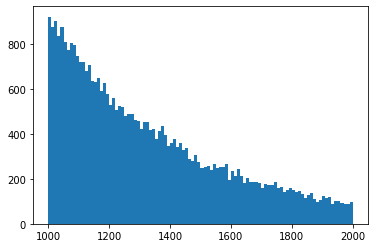

In [24]:
bin_edges = np.arange(1000, 2000 + 10, 10)
plt.hist(data=bikeshare_data, x='duration_sec', bins=bin_edges);

<br>
There are no strange observations present in this distribution, which appears to be a fairly standard unimodal curve that is right-skewed. 

## Distribution of Ride Duration 
Ride durations vary widely, from 60 seconds to 60,000 seconds. Plotted on a logarithmic scale, the distribution of Ride duration takes on a symmetric unimodal shape.

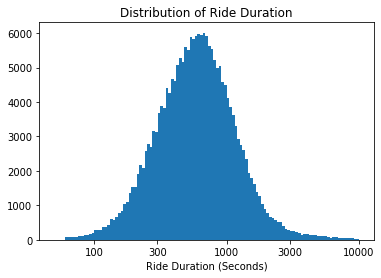

In [25]:
log_bin_edges = np.arange(1.7, 4.0 + 0.02, 0.02)
plt.hist(np.log10(bikeshare_data['duration_sec']), bins=log_bin_edges)
locs, labels = plt.xticks()
ticks = [100, 300, 1000, 3000, 10000];
log_ticks = np.log10(ticks)
# print(log_ticks)
plt.xticks(log_ticks, ticks)
plt.xlabel('Ride Duration (Seconds)')
plt.title('Distribution of Ride Duration');

<br>
Thanks to the sweeping long tail of the original distribution, we get a near-perfect bell curve of the data.  

#### Let's analyze the start time:

<br>
Analyzing the frequecies of start times or end times each day over a month can provide insight into certain events or trends that may have occured on a specific day or a range of days that may have led to an increase or drop in rides on that day. This information can be utilized by Lyft to offer relevant perks to riders, etc..

In [26]:
start_time_datetime = bikeshare_data['start_time'].sort_values(ascending=True)
start_time_datetime.describe()

count                         210563
unique                        210550
top       2019-08-19 08:36:36.680000
freq                               2
first     2019-08-01 00:04:27.953000
last      2019-08-31 23:59:43.391000
Name: start_time, dtype: object

Interesting, so it looks like we just have data ranging from the start to the end of october. This will make it much easier to deal with DateTime objects after casting, as we can just plot by the day of the month, treated as a discrete numeric variable.

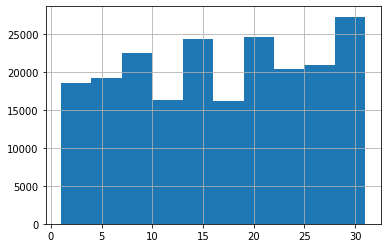

In [27]:
start_time_datetime_day = start_time_datetime.apply(lambda x: x.day)
start_time_datetime_day.hist();

Yeah...Let's make the plot better

## Adapted Bar Chart: No. of Rides per Day vs. Day of Month (August)
It can be shown by the chart that there are greater number of rides during the weekdays (each peak of 5 days) compared to weekends.

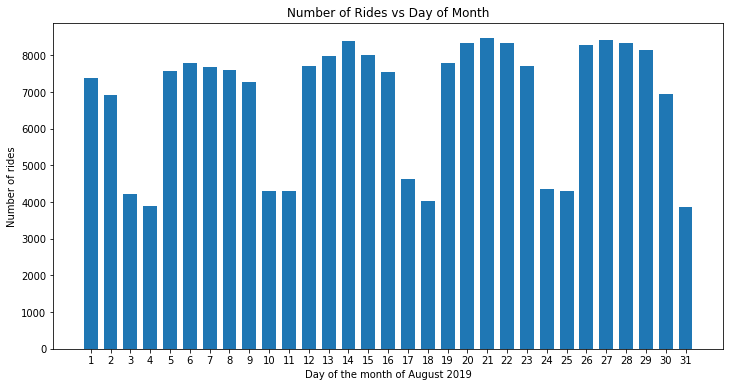

In [28]:
plt.figure(figsize=(12, 6))
bin_edges = np.arange(0.5, 30.5 + 1.1, 1)
plt.hist(start_time_datetime_day, bins=bin_edges, rwidth=0.7)
plt.xticks(np.arange(1, 31 + 1, 1))
plt.xlabel('Day of the month of August 2019')
plt.ylabel('Number of rides')
plt.title('Number of Rides vs Day of Month');

The pattern seen here is interesting, but also obvious, as each wave of 5 high bars represent weekdays, which of course have higher frequencies than the 2 'weekend' bars that separate them. Generally, it appears that Mondays and Fridays usually contain lower frequencies compared to Tuesdays and Thursdays, which in turn are usually lower than Wednesdays. When it comes to the weekend, it appears that Saturday has generally slightly higher frequencies than Sunday.

In [29]:
end_time_datetime = bikeshare_data['start_time'].sort_values(ascending=True)
end_time_datetime.describe()

count                         210563
unique                        210550
top       2019-08-19 08:36:36.680000
freq                               2
first     2019-08-01 00:04:27.953000
last      2019-08-31 23:59:43.391000
Name: start_time, dtype: object

#### Let's analyze the end time:

<br>
Similar to the start time, the end time data ranges for over a month. Let's plot it.

In [30]:
end_time_datetime_day = end_time_datetime.apply(lambda x: x.day)

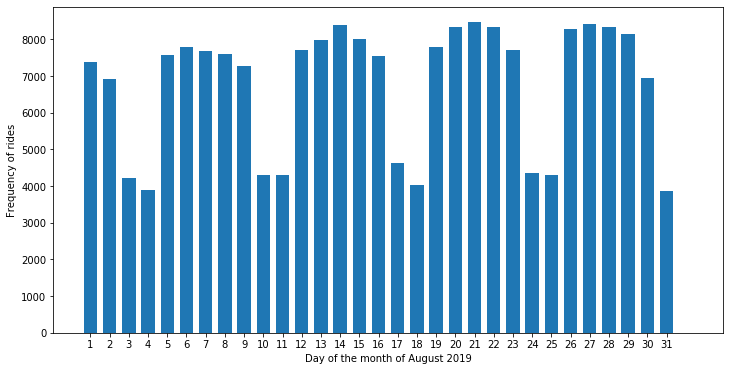

In [31]:
plt.figure(figsize=(12, 6))
bin_edges = np.arange(.5, 31.5 + 1.1, 1)
plt.hist(end_time_datetime_day, bins=bin_edges, rwidth=0.7)
plt.xticks(np.arange(1, 30 + 1.1, 1))
plt.xlabel('Day of the month of August 2019')
plt.ylabel('Frequency of rides');

The notable patterns in the end time dataset are similar to that of the start time dataset above. Soon after plotting this, it appeared that it was exactly the same distribution as the start time dataset, as the position of all the bars all seem to be the same. To discern if there were indeed any differences in the frequencies between the 2 datasets (for example, if a rider rents out a bike but doesn't return it), I chose specific bar values and compared them: 

In [32]:
# (start time == 4, end time == 4)
(start_time_datetime_day == 4).sum(), (end_time_datetime_day == 4).sum()

(3885, 3885)

In [33]:
# (start time == 13, end time == 13)
(start_time_datetime_day == 13).sum(), (end_time_datetime_day == 13).sum()

(7997, 7997)

In [34]:
# (start time == 20, end time == 20)
(start_time_datetime_day == 20).sum(), (end_time_datetime_day == 20).sum()

(8333, 8333)

In [35]:
4 in np.arange(0, 4)

False

<br>
So as expected, there are minute value differences between the two frequency distributions. 

Let's add the 'day of the month' to the dataset with respect to the start and end of the ride.<br>
Let's also add the 'weekend/weekday' info to the dataset with respect to the start and end of the ride.

In [36]:
bikeshare_data['start_month_date'] = start_time_datetime_day
bikeshare_data['end_time_date'] = end_time_datetime_day

# True if weekday, False if weekend
bikeshare_data['start_is_weekday'] = start_time_datetime.apply(lambda x: (x.weekday() in np.arange(0, 5)))
bikeshare_data['end_is_weekday'] = end_time_datetime.apply(lambda x: (x.weekday() in np.arange(0, 5)))

In [37]:
bikeshare_data

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,...,user_type,member_birth_year,member_gender,bike_share_for_all_trip,route_distance,member_age,start_month_date,end_time_date,start_is_weekday,end_is_weekday
0,68145,2019-08-31 21:27:42.253,2019-09-01 16:23:27.492,249,Russell St at College Ave,37.858473,-122.253253,247,Fulton St at Bancroft Way,37.867789,...,Customer,NaN,NaN,No,1.518700,NaN,31,31,False,False
1,53216,2019-08-31 22:34:17.512,2019-09-01 13:21:13.931,368,Myrtle St at Polk St,37.785434,-122.419622,78,Folsom St at 9th St,37.773717,...,Customer,1993.0,Female,No,1.479856,26.0,31,31,False,False
2,53182,2019-08-31 22:34:49.942,2019-09-01 13:21:12.457,368,Myrtle St at Polk St,37.785434,-122.419622,78,Folsom St at 9th St,37.773717,...,Customer,1995.0,Male,No,1.479856,24.0,31,31,False,False
3,75682,2019-08-31 14:22:02.278,2019-09-01 11:23:24.511,104,4th St at 16th St,37.767045,-122.390833,126,Esprit Park,37.761634,...,Subscriber,1993.0,Female,No,0.602006,26.0,31,31,False,False
4,30849,2019-08-31 18:47:08.057,2019-09-01 03:21:17.697,327,5th St at San Salvador St,37.332039,-121.881766,327,5th St at San Salvador St,37.332039,...,Customer,NaN,NaN,No,0.000000,NaN,31,31,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210558,728,2019-08-01 00:07:37.039,2019-08-01 00:19:45.776,67,San Francisco Caltrain Station 2 (Townsend St...,37.776639,-122.395526,17,Embarcadero BART Station (Beale St at Market St),37.792251,...,Subscriber,1983.0,Male,No,1.741902,36.0,1,1,True,True
210559,761,2019-08-01 00:06:23.830,2019-08-01 00:19:05.550,151,53rd St at Hollis St,37.836182,-122.287180,159,24th St at Market St,37.816060,...,Subscriber,1982.0,Female,No,2.371914,37.0,1,1,True,True
210560,331,2019-08-01 00:08:28.757,2019-08-01 00:14:00.135,30,San Francisco Caltrain (Townsend St at 4th St),37.776598,-122.395282,62,Victoria Manalo Draves Park,37.777791,...,Subscriber,1994.0,Male,No,0.989187,25.0,1,1,True,True
210561,111,2019-08-01 00:11:02.582,2019-08-01 00:12:54.134,183,Telegraph Ave at 19th St,37.808702,-122.269927,180,Telegraph Ave at 23rd St,37.812678,...,Subscriber,1993.0,Male,No,0.453759,26.0,1,1,True,True


#### Let's examine the start_station_name data:

In [38]:
bikeshare_data['start_station_name'].describe()

count                                                210563
unique                                                  377
top       San Francisco Caltrain Station 2  (Townsend St...
freq                                                   5196
Name: start_station_name, dtype: object

In [39]:
bikeshare_data['start_station_name'].value_counts().head()

San Francisco Caltrain Station 2  (Townsend St at 4th St)    5196
Berry St at 4th St                                           4156
San Francisco Ferry Building (Harry Bridges Plaza)           3714
Market St at 10th St                                         3543
Montgomery St BART Station (Market St at 2nd St)             3092
Name: start_station_name, dtype: int64

The above cell provide the count of the data in the series (column), the number of unique categorical data, the most frequent category, and its respective frequency. 

Let's look at the least frequent start station and its frequency:

In [40]:
bikeshare_data['start_station_name'].value_counts().tail()

Utah St at 24th St                11
1st St at Younger Ave              8
21st Ave at International Blvd     7
MTL-ECO5-01                        3
16th St Depot                      2
Name: start_station_name, dtype: int64

#### Let's examine the member age:

In [41]:
bikeshare_data['member_age'].describe()

count    170774.000000
mean         34.035550
std          10.037432
min          18.000000
25%          27.000000
50%          32.000000
75%          39.000000
max         141.000000
Name: member_age, dtype: float64

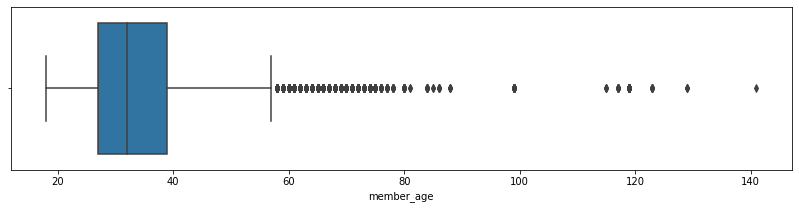

In [42]:
plt.figure(figsize=(14, 3))
color = sb.color_palette()[0]
sb.boxplot(data=bikeshare_data, x='member_age');

While statistics such as the mean, median, and max values make sense for this category, it seems ridiculous to have users born before 1960 and even 1900 who choose to use bikeshare services, as seen by the outliers. It is clear in this case that this is abruptly incorrect data that is chosen by certain users, who were most likely in a hurry to register for the service and did not mind the inaccurate data.

Let's drop that possibly incorrect data by having a cutoff age of 70:

In [43]:
drop_ages = bikeshare_data[bikeshare_data['member_age'] > 70.0]
bikeshare_data.drop(index=drop_ages.index, inplace=True)

## Boxplot: Rider Age
This boxplot shows that the median age of Lyft Bikeshare members is 34, with a minimum of age 18, a median of 32, and a third quartile of 39. There are members that are well into the 50s, however.

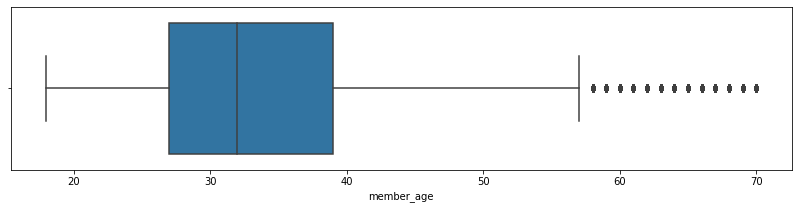

In [44]:
plt.figure(figsize=(14, 3))
color = sb.color_palette()[0]
sb.boxplot(data=bikeshare_data, x='member_age');

#### Let's analyze the user type:

In [45]:
bikeshare_data['user_type'].value_counts()

Subscriber    164567
Customer       45622
Name: user_type, dtype: int64

In [46]:
bikeshare_data['user_type'].value_counts() / bikeshare_data['user_type'].shape[0]

Subscriber    0.782948
Customer      0.217052
Name: user_type, dtype: float64

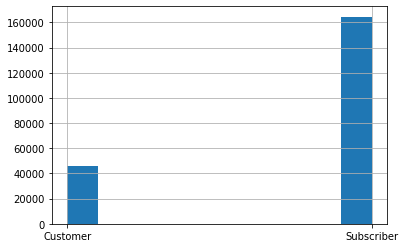

In [47]:
bikeshare_data['user_type'].hist();

## Customers vs Subscribers
Of the rides present in this dataset, there are much higher frequencies of subscribers compared to customers.

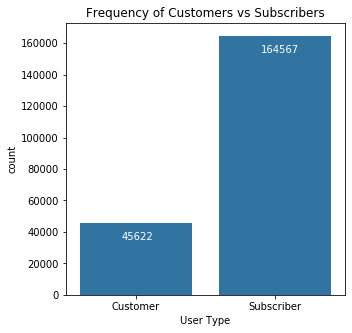

In [48]:
plt.figure(figsize=(5, 5))
color = sb.color_palette()[0]
sb.countplot(data=bikeshare_data, x='user_type', color=color)
custCount = (bikeshare_data['user_type'] == 'Customer').sum()
subCount = (bikeshare_data['user_type'] == 'Subscriber').sum()
# print(custCount)
# print(subCount)
plt.rcParams['text.color'] = 'white';
plt.text(0-0.1, custCount - 10500, '{:.0f}'.format(custCount))
plt.text(1-0.1, subCount - 10500, '{:.0f}'.format(subCount))
plt.rcParams['text.color'] = 'black';
plt.xlabel('User Type')
plt.title('Frequency of Customers vs Subscribers');

In [49]:
plt.rcParams['text.color'] = 'black';

Substantially more users are subscribers than customers.

#### Let's analyze the member gender: 

In [50]:
bikeshare_data['member_gender'].value_counts()

Male      128005
Female     39979
Other       2419
Name: member_gender, dtype: int64

In [51]:
bikeshare_data['member_gender'].value_counts() / bikeshare_data['member_gender'].shape[0]

Male      0.609000
Female    0.190205
Other     0.011509
Name: member_gender, dtype: float64

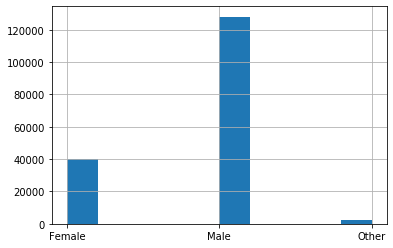

In [52]:
bikeshare_data['member_gender'].hist();

Many more males choose to use the bikeshare service than females or other gender identifications.

#### Mean and other statistics on the distance traveled by the users in this dataset:

In [53]:
bikeshare_data['route_distance'].describe()

count    210189.000000
mean          1.675929
std           1.061158
min           0.000000
25%           0.931771
50%           1.445961
75%           2.191391
max          67.465996
Name: route_distance, dtype: float64

<br>
The mean distance traveled in each ride is 1.67 miles, with the lowest value being 0 (bike is returned to the same station) and the maximum distance is a whopping 67 miles! Let's see its distribution:

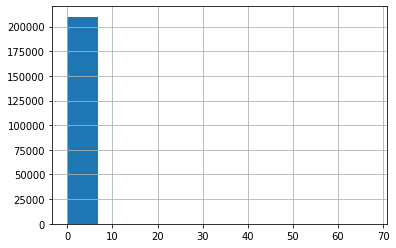

In [54]:
bikeshare_data['route_distance'].hist();

Let's zoom in and make the plot more interpretable:

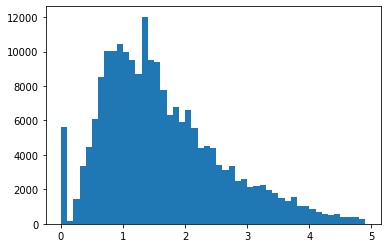

In [55]:
bin_edges = np.arange(0, 5, 0.1)
plt.hist(data=bikeshare_data, x='route_distance', bins=bin_edges);

There's a slight right skew present. Let's apply a logarithmic scale:

## Ride Distance
With a logarithmic scale applied, the ride distance takes on a relatively symmetric shape. There is a jump of frequencies on 0 miles, as several users choose to dock at the same bike station from where they left their bikes. 

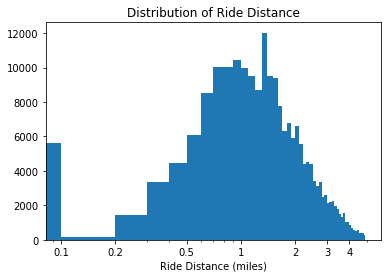

In [56]:
bin_edges = np.arange(0, 5, 0.1)
plt.hist(data=bikeshare_data, x='route_distance', bins=bin_edges)
plt.xscale('log')
labels = np.arange(0, 2, 1)
plt.xticks([0.1, 0.2, 0.5, 1, 2, 3, 4], ['0.1', '0.2', '0.5', '1', '2', '3', '4'])
# plt.xticks(labels, labels);
plt.xlabel('Ride Distance (miles)')
plt.title('Distribution of Ride Distance');

That's better!

# Bi-variate exploration

We will investigate relationships between pairs of these variables, particularly how each of them relate to the end station.

#### Let's investigate the relationship between the duration and the day of commute

In [57]:
bikeshare_data.columns

Index(['duration_sec', 'start_time', 'end_time', 'start_station_id',
       'start_station_name', 'start_station_latitude',
       'start_station_longitude', 'end_station_id', 'end_station_name',
       'end_station_latitude', 'end_station_longitude', 'bike_id', 'user_type',
       'member_birth_year', 'member_gender', 'bike_share_for_all_trip',
       'route_distance', 'member_age', 'start_month_date', 'end_time_date',
       'start_is_weekday', 'end_is_weekday'],
      dtype='object')

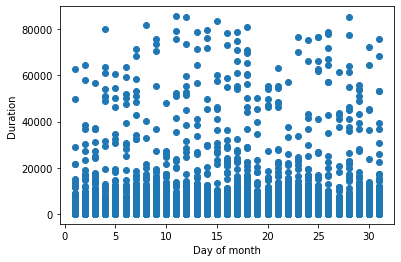

In [58]:
plt.scatter(y=bikeshare_data['duration_sec'], x=bikeshare_data.start_time.dt.day)
plt.ylabel('Duration')
plt.xlabel('Day of month');

The data is not so clear with a scatterplot. Let's try a line plot with a mean duration estimate for each day:

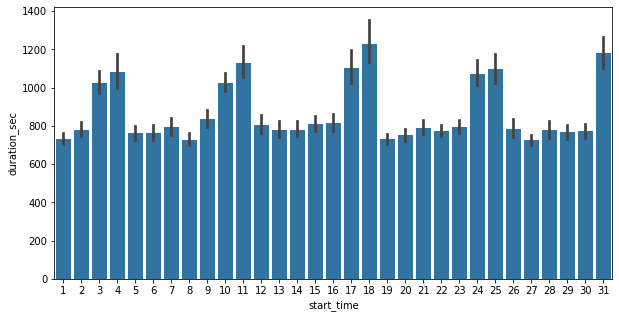

In [59]:
plt.figure(figsize=(10, 5))
sb.barplot(data=bikeshare_data, x=bikeshare_data.start_time.dt.day, y='duration_sec', color=color);


Interesting, so it looks like there was increased average ride duration for users over the weekends. So even if there tend to be more users during weekdays, users rode the longest over the weekend.

When it comes to day of the week, so far, I have only been assuming that the jumps in the frequencies correspond to weekend/weekday differences. To be sure of this, let's quickly add a categorical day of the week variable from the datetime data to the plot:

## Average Ride Duration vs Day of Month (Aug)
It can be seen from the plot that users tend to ride for longer over the weekends (in blue) compared to weekdays (orange). This pattern seems to be kept relatively steady. 

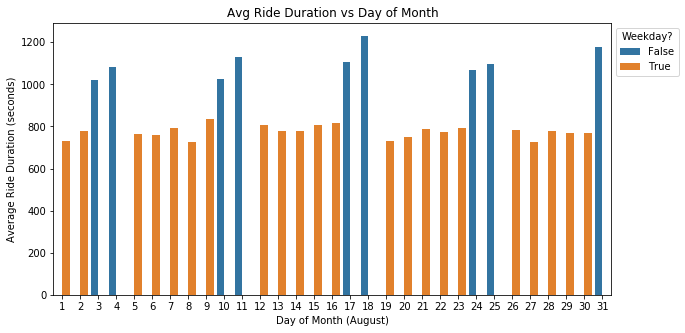

In [60]:
plt.figure(figsize=(10, 5))
sb.barplot(data=bikeshare_data, x=bikeshare_data.start_time.dt.day, y='duration_sec', color=color, hue='start_is_weekday', palette=sb.color_palette(n_colors=2), ci=None)
plt.legend(title='Weekday?', bbox_to_anchor=(1, 1))
plt.xlabel('Day of Month (August)')
plt.ylabel('Average Ride Duration (seconds)')
plt.title('Avg Ride Duration vs Day of Month');

Next, I would like to see if a particular end station is associated with having more users that are subscribers. There are 377 unique stations in the end station column, so it would not be ideal to take all of them into account for a visual. Instead, I will take the top 15 stations in terms of frequency, and go from there. 

In [61]:
# Query the data that includes the top 15 end stations

# Array that contains the top 15 stations
top_15_end_stations = bikeshare_data['end_station_name'].value_counts().head(15).index.values
# Use a lambda function within a mask query to get the data that has one of the top 15 end stations as its end station
top_15_end_stations_data = bikeshare_data[bikeshare_data['end_station_name'].apply(lambda x: x in top_15_end_stations)]
top_15_end_stations_data.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,...,user_type,member_birth_year,member_gender,bike_share_for_all_trip,route_distance,member_age,start_month_date,end_time_date,start_is_weekday,end_is_weekday
5,17193,2019-08-31 20:52:40.744,2019-09-01 01:39:14.592,49,S Park St at 3rd St,37.780760,-122.394989,3,Powell St BART Station (Market St at 4th St),37.786375,...,Customer,NaN,NaN,No,1.072285,NaN,31,31,False,False
16,1157,2019-08-31 23:56:47.981,2019-09-01 00:16:05.457,80,Townsend St at 5th St,37.775235,-122.397437,5,Powell St BART Station (Market St at 5th St),37.783899,...,Subscriber,1983.0,Male,No,1.365764,36.0,31,31,False,False
38,441,2019-08-31 23:40:32.035,2019-08-31 23:47:53.201,17,Embarcadero BART Station (Beale St at Market St),37.792251,-122.397086,3,Powell St BART Station (Market St at 4th St),37.786375,...,Customer,NaN,NaN,No,0.948390,NaN,31,31,False,False
45,711,2019-08-31 23:31:15.550,2019-08-31 23:43:07.441,324,Union Square (Powell St at Post St),37.788300,-122.408531,44,Civic Center/UN Plaza BART Station (Market St ...,37.781074,...,Customer,NaN,NaN,No,0.851798,NaN,31,31,False,False
89,268,2019-08-31 23:02:27.431,2019-08-31 23:06:55.651,28,The Embarcadero at Bryant St,37.787168,-122.388098,22,Howard St at Beale St,37.789756,...,Subscriber,1985.0,Male,Yes,0.643325,34.0,31,31,False,False


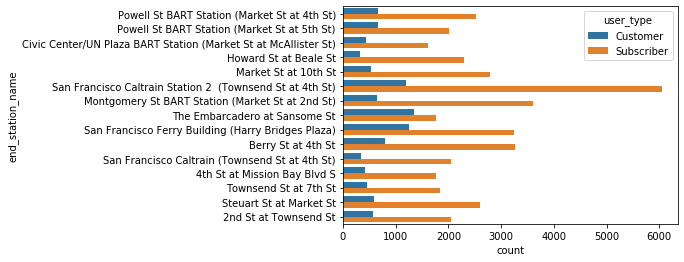

In [62]:
plt.rcParams['text.color'] = 'black'
sb.countplot(data=top_15_end_stations_data, y='end_station_name', hue='user_type');

Interesting, so it seems that seems that there are consistently more subscribers than customers at these stations with a relatively steady ratio, with one glaring exception: San Francisco Caltrain Station 2. This station has far more subscribers than any other station. This doesn't come as too much of a surprise, as this station also has the highest frequency as noted from the univariate investigation. 

<br>
Now, let's measure how many rides are for leisure and how many are used for commuting (see if end destination matches start destination).

## Commute vs. Leisure Rides
Whether a particular ride is considered a commute or a leisure ride depends on whether the end station matches the start station. If so, it is a leisure ride. 

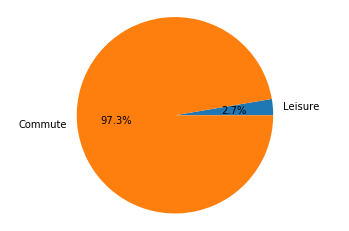

In [63]:
leisure_rides_sum = (bikeshare_data['start_station_name'] == bikeshare_data['end_station_name']).sum() #/ bikeshare_data['start_station_name'].shape[0]
commute_rides_sum = bikeshare_data['start_station_name'].shape[0] - leisure_rides_sum
arr = [leisure_rides_sum, commute_rides_sum]
# commute_rides_prop = 1 - leisure_rides_prop
plt.pie(arr, autopct='%1.1f%%', startangle=0, labels=('Leisure', 'Commute'))
plt.axis('equal');


Now, let's compare user type and gender:

## Gender and User Type
The plot below is an adapted bar chart measuring the frequency of each gender and the average number of customers of subscribers of each gender. There appear to be much more male subscribers than any other area. For each gender, the number of customers is a mere fraction compared to the number of subscribers present.

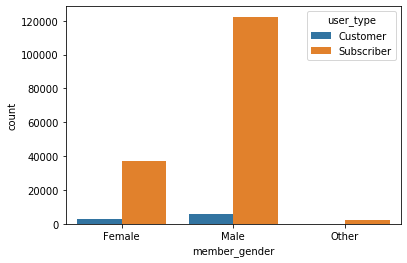

In [64]:
sb.countplot(data=bikeshare_data, x='member_gender', hue='user_type');

Next, let's see if users who choose to subscribe ride longer distances compared to those who haven't subscribed: 

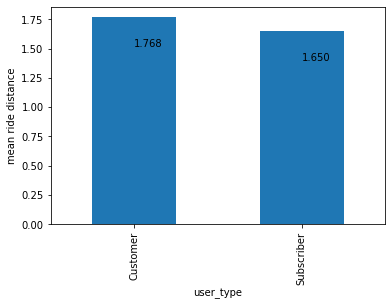

In [65]:
bikeshare_data.groupby('user_type')['route_distance'].mean().plot(kind='bar')

customer_mean_distance = bikeshare_data.groupby('user_type')['route_distance'].mean()['Customer']
subscriber_mean_distance = bikeshare_data.groupby('user_type')['route_distance'].mean()['Subscriber']

plt.text(0, customer_mean_distance - .25, '{:.3f}'.format(customer_mean_distance)) # 1.768
plt.text(1, subscriber_mean_distance - .25, '{:.3f}'.format(subscriber_mean_distance)) # 1.650

plt.ylabel('mean ride distance');

It looks like non-subscribers ride slightly more on average compared to subscribers.

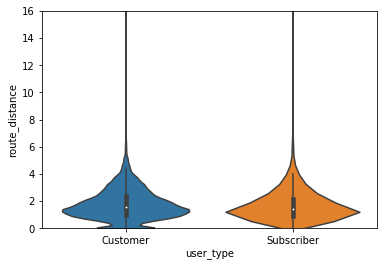

In [66]:
sb.violinplot(data=bikeshare_data, x='user_type', y='route_distance')
plt.ylim(top=16, bottom=0);

Let's see if more distance is covered on average by users on weekdays compared to weekends:

In [67]:
# True if weekday, False if weekend
weekend_data = bikeshare_data[bikeshare_data['start_is_weekday'] == False]
weekday_data = bikeshare_data[bikeshare_data['start_is_weekday'] == True]

weekend_distance = weekend_data['route_distance'].mean()
weekday_distance = weekday_data['route_distance'].mean()


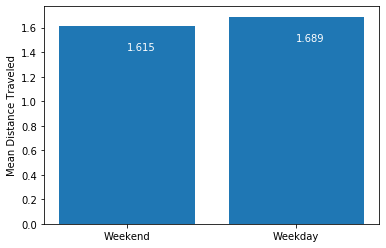

In [68]:
plt.bar(x=[0, 1], height=[weekend_distance, weekday_distance])
locs, labels = plt.xticks()
# plt.xticks(locs, '')
plt.xticks([0, 1], ['Weekend', 'Weekday'])
plt.ylabel('Mean Distance Traveled')
plt.rcParams['text.color'] = 'white'
plt.text(0, weekend_distance - .2, '{:.3f}'.format(weekend_distance)) 
plt.text(1, weekday_distance - .2, '{:.3f}'.format(weekday_distance)); 

On average, users ride slightly more on weekdays than weekends

In [69]:
plt.rcParams['text.color'] = 'black'

Let's plot the route distance against the ride duration for each ride in the dataset:

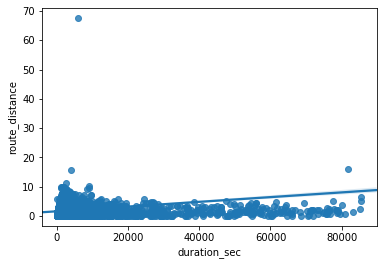

In [70]:
sb.regplot(data=bikeshare_data, x='duration_sec', y='route_distance');

Interesting, it looks like one outlier is present, which contains a route between 60 and 70 miles, which is dragging this plot way out of scope. Let's see if we can drop it. 

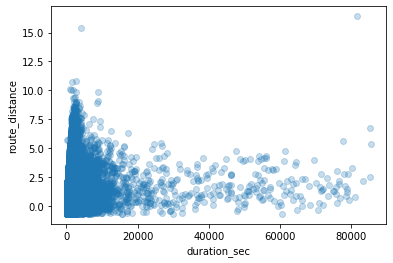

In [71]:
drop_row = bikeshare_data[bikeshare_data['route_distance'] > 60]
bikeshare_data.drop(index=drop_row.index, inplace=True)
sb.regplot(data=bikeshare_data, x='duration_sec', y='route_distance', fit_reg=False, x_jitter=0.7, y_jitter=0.7, scatter_kws={'alpha':1/4});


I want to know the age range of who rides for the most time/longest distance. This plot will be shown in the multivariate section.

Contrary to basic logic, ride duration in this case does not necessarily have a linear relationship with route distance traveled. A longer ride doesn't mean more distance is covered.

In [72]:
bikeshare_data.iloc[1]

duration_sec                                    53216
start_time                 2019-08-31 22:34:17.512000
end_time                   2019-09-01 13:21:13.931000
start_station_id                                  368
start_station_name               Myrtle St at Polk St
start_station_latitude                        37.7854
start_station_longitude                       -122.42
end_station_id                                     78
end_station_name                  Folsom St at 9th St
end_station_latitude                          37.7737
end_station_longitude                        -122.412
bike_id                                          2440
user_type                                    Customer
member_birth_year                                1993
member_gender                                  Female
bike_share_for_all_trip                            No
route_distance                                1.47986
member_age                                         26
start_month_date            

# Multi-variate exploration

Our focus is on patterns involving end stations, so let's compare the average ages of users for the top 15 stations to that of the lowest 15 stations.

In [73]:
# Get the top 15 stations

top_15_end_stations_data.head(2)

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,...,user_type,member_birth_year,member_gender,bike_share_for_all_trip,route_distance,member_age,start_month_date,end_time_date,start_is_weekday,end_is_weekday
5,17193,2019-08-31 20:52:40.744,2019-09-01 01:39:14.592,49,S Park St at 3rd St,37.780760,-122.394989,3,Powell St BART Station (Market St at 4th St),37.786375,...,Customer,NaN,NaN,No,1.072285,NaN,31,31,False,False
16,1157,2019-08-31 23:56:47.981,2019-09-01 00:16:05.457,80,Townsend St at 5th St,37.775235,-122.397437,5,Powell St BART Station (Market St at 5th St),37.783899,...,Subscriber,1983.0,Male,No,1.365764,36.0,31,31,False,False


In [74]:
# Get the lowest 15 stations

# Array that contains the lowest 15 stations
low_15_end_stations = bikeshare_data['end_station_name'].value_counts().tail(15).index.values
# Use a lambda function within a mask query to get the data that has one of the top 15 end stations as its end station
low_15_end_stations_data = bikeshare_data[bikeshare_data['end_station_name'].apply(lambda x: x in low_15_end_stations)]
low_15_end_stations_data.head(2)

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,...,user_type,member_birth_year,member_gender,bike_share_for_all_trip,route_distance,member_age,start_month_date,end_time_date,start_is_weekday,end_is_weekday
717,718,2019-08-31 19:02:26.462,2019-08-31 19:14:24.506,313,Almaden Blvd at San Fernando St,37.331415,-121.8932,427,Auzerais Ave at Lincoln Ave,37.320969,...,Customer,NaN,NaN,No,1.770031,NaN,31,31,False,False
719,674,2019-08-31 19:03:04.390,2019-08-31 19:14:19.366,313,Almaden Blvd at San Fernando St,37.331415,-121.8932,427,Auzerais Ave at Lincoln Ave,37.320969,...,Customer,NaN,NaN,No,1.770031,NaN,31,31,False,False


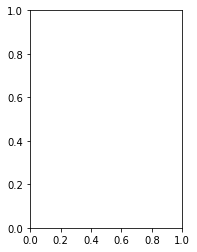

In [75]:
plt.subplot(1, 2, 1)


I want to know the age range of who rides for the most time/longest distance. This plot will be shown in the multivariate section.

/anaconda3/lib/python3.6/site-packages/seaborn/axisgrid.py:230: UserWarning: The `size` paramter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


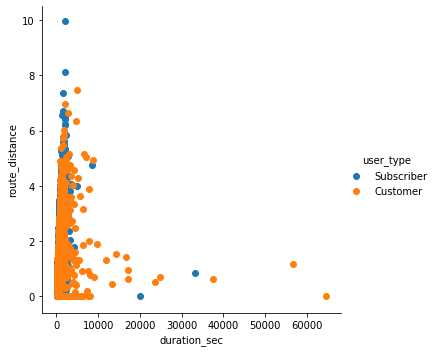

In [76]:
sample_data = bikeshare_data.sample(5000)
g = sb.FacetGrid(data=sample_data, hue='user_type', size=5)
g.map(plt.scatter, 'duration_sec', 'route_distance')
g.add_legend();

Narrow the x limit:

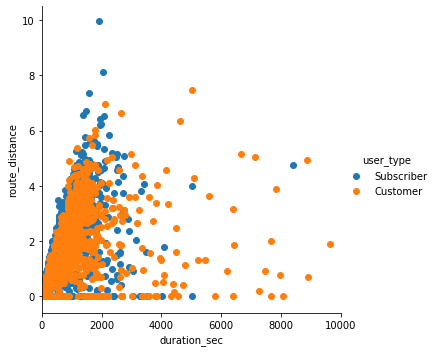

In [77]:
g = sb.FacetGrid(data=sample_data, hue='user_type', size=5)
g.map(plt.scatter, 'duration_sec', 'route_distance')
g.add_legend()
plt.xlim(xmin=0, xmax=10000);

Instead of narrowing the limit, <br>
Let's try a log Scale transformation on x axis: 

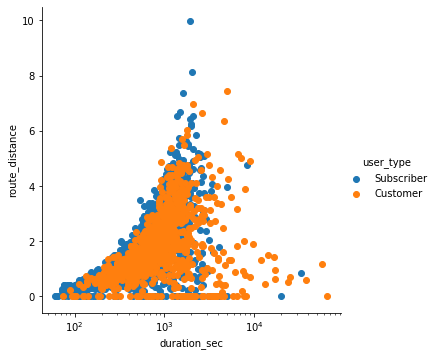

In [78]:
g = sb.FacetGrid(data=sample_data, hue='user_type', size=5)
g.map(plt.scatter, 'duration_sec', 'route_distance')
g.add_legend()
plt.xscale('log');

Let's try cube root scale transformation on x axis:

In [79]:
def cbrt_trans(x, inverse=False):
    '''Transformation helper function'''
    if not inverse:
        return np.cbrt(x)
    else:
        return x**3

## Ride Distance(miles) vs Duration(seconds)
This scatterplot with a color-encoded variable for the user type shows that there is a correlation present with the riding distance compared with the amount of time spent on the bike. A cube-root scale transformation applied to this plot helps show the data increasing in a more linear fashion. 

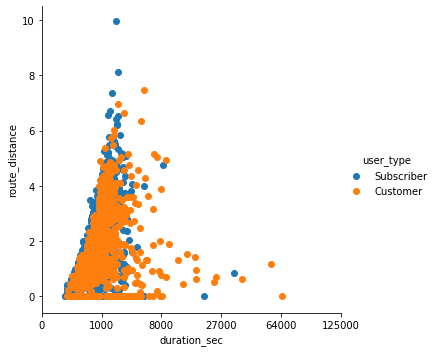

In [80]:
trans_data_copy = sample_data.copy()
temp_trans_duration = trans_data_copy['duration_sec'].apply(cbrt_trans)
trans_data_copy['duration_sec'] = temp_trans_duration
g = sb.FacetGrid(data=trans_data_copy, hue='user_type', size=5)
g.map(plt.scatter, 'duration_sec', 'route_distance')
tick_locs = np.arange(0, trans_data_copy['duration_sec'].max()+10, 10)
plt.xticks(tick_locs, cbrt_trans(tick_locs, inverse=True).astype(int))
g.add_legend();

I feel that the cube root transformation helps to better accurately judge the distribution of route distance vs duration.

# Interactive Plot Section

In [88]:
import plotly.express as px

In [116]:
fig = px.box(data_frame=bikeshare_data, x='member_age', height=500, width=600)
fig.update_xaxes(title_text="Member Age")
fig.update_traces(orientation='h')
fig.show()

In [119]:
bikeshare_data.columns

Index(['duration_sec', 'start_time', 'end_time', 'start_station_id',
       'start_station_name', 'start_station_latitude',
       'start_station_longitude', 'end_station_id', 'end_station_name',
       'end_station_latitude', 'end_station_longitude', 'bike_id', 'user_type',
       'member_birth_year', 'member_gender', 'bike_share_for_all_trip',
       'route_distance', 'member_age', 'start_month_date', 'end_time_date',
       'start_is_weekday', 'end_is_weekday'],
      dtype='object')

In [122]:
import plotly.graph_objects as go

In [129]:
d = {'Duration':bikeshare_data['duration_sec'], 'Route distance':bikeshare_data['route_distance'], 'Rider age':bikeshare_data['member_age']}
samp_df = pd.DataFrame(data=d)
samp_df.dropna(inplace=True)
fig = go.Figure(data=[go.Surface(z=samp_df.values)])
# fig.update_layout(title='Rider Analysis', autosize=False, width=500, height=500, margin=dict(l=65, r=50, b=65, t=90))
# fig.update_zaxes(title_text="Ride Duration (s)")
# fig.update_yaxes(title_text="Route Distance (mi)")
# fig.update_zaxes(title_text="Route Distance (mi)")
fig.show()

In [131]:
samp_df.describe()
# z is ride duration
# 

,Duration,Route distance,Rider age
count,170399.000000,170399.000000,170399.000000
mean,709.589892,1.659990,33.923984
std,1367.351410,1.032247,9.724181
min,61.000000,0.000000,18.000000
25%,355.000000,0.919649,27.000000
50%,555.000000,1.423041,32.000000
75%,839.000000,2.172215,39.000000
max,80893.000000,11.342882,70.000000


In [110]:
fig = px.scatter(data_frame=sample_data, x='duration_sec', y='route_distance', height=500, width=600)
fig.update_xaxes(title_text="Ride Duration (s)")
fig.update_yaxes(title_text="Route Distance (mi)")
fig.show()